In [323]:
import numpy as np
from numpy import nan
from catboost import CatBoostRegressor, Pool, EFstrType, CatBoostClassifier
import pandas as pd
from lifelines.statistics import sample_size_necessary_under_cph , KaplanMeierFitter


In [324]:
ex1 = pd.read_csv('table_ml.csv' )
ex = pd.read_csv('table_ml_may21.csv' )

In [325]:
#set(ex.columns.values) - set(ex1.columns.values)

#### Impute missing values: decided not to impute because of concerns of massive imputations of features either too relevant for disease under study (such as temperature) and/or with elevated % of missings, where a NaN has clinical meaning (e.g a lab test is not done because it is judged as not indicated, or because it was already done at prior time). Instead variables that are NaN but corresponds to 0 (e.g. tx_day_1) would leak treatment effect such as duration of admissions for the ML pharma predictor up to first day (some patients died and hence tx_day_1 is NaN but not 0), those are replaced with 0

In [326]:
var_imput = ['tx_day_1' ]
var_imput = [x for x in ex.columns.values if any(substring in x for substring in var_imput)]
ex[var_imput] = ex[var_imput].fillna(0)
ex[var_imput].head()

,tx_day_1_Anakinra,tx_day_1_Azitromicina,tx_day_1_Baricitinib,tx_day_1_Bemiparina,tx_day_1_Ciclosporina,tx_day_1_Cloroquina,tx_day_1_Corticoides,tx_day_1_Darunavir_cobicistat,tx_day_1_Dexametasona,tx_day_1_Enoxaparina,tx_day_1_G-CSF,tx_day_1_Heparina,tx_day_1_Hidroxicloroquina,tx_day_1_Interferon_beta_1a,tx_day_1_Interferon_beta_1b,tx_day_1_Ivermectina,tx_day_1_Lopinavir_ritonavir,tx_day_1_Metilprednisolona,tx_day_1_Remdesivir,tx_day_1_Ruxolitinib,tx_day_1_Tacrolimus,tx_day_1_Tiamina_vitamina_B1,tx_day_1_Tocilizumab,tx_day_1_Tofacitinib,tx_day_1_Vitamina_D,tx_day_1_Zinc
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,40.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [327]:
ex = ex[ex.covid_adm == 1]

## Estabilized inverse probability-of-treatment weights
### Estimating treatment propensity scores 
estimating propensity scores by fitting ML model with the treatment indicator as
the dependent variable and other covariates measured
before the treatment assignment as the independent
variables. Although there is no consensus as to which
covariates to include in the logistic model, in most circumstances,
it is appropriate to include all measured pretreatment
baseline characteristics regardless if they are
balanced or not between the two groups. Including posttreatment
characteristics in this model should be
considered with great caution and should be included
only if they are not affected by the treatment

### Select independent variables

In [328]:
drop = ['Anakinra',
 'Azitromicina',
 'Baricitinib',
 'Bemiparina',
 'Ciclosporina',
 'Cloroquina',
 'Convalescent_plasma',
 'Corticoides',
 'Darunavir_cobicistat',
 'Dexametasona ',
 'Eculizumab',
 'Enoxaparina',
 'Fosamprenavir',
 'G-CSF',
 'Heparina',
 'Hidroxicloroquina',
 'Inmunoglobulinas',
 'Interferon_beta_1a',
 'Interferon_beta_1b',
 'Ivermectina',
 'Lopinavir_ritonavir',
 'Metilprednisolona',
 'Remdesivir',
 'Ruxolitinib',
 'Sarilumab',
 'Siltuximab',
 'Tacrolimus',
 'Tiamina_vitamina_B1',
 'Tocilizumab',
 'Tofacitinib',
 'Vitamina_C',
 'Vitamina_D',
 'Zinc',]

In [329]:

drop1 = ['covid_adm', 'dx', '_patient_id', 'covid_rel_dx', 'tx_bin','tx_set', 'tx_set_string', 'date_in']


In [330]:
ex['tx_bin_Dummy'] = 0
sample = ex.sample(frac=0.5,  random_state=42).index.values
ex.loc[ex.index.isin(sample), ['tx_bin_Dummy']] = 1
ex.loc[ex.index.isin(sample), ['tx_delta_init_Dummy']] = 1
ex.loc[ex.index.isin(sample[:1300]), ['tx_delta_init_Dummy']] = 5

In [331]:
tt = 'Dummy'
ex[f'tx_bin_{tt}'].value_counts()

1    4486
0    4485
Name: tx_bin_Dummy, dtype: int64

In [332]:
ex = ex.loc[(ex[f'tx_delta_init_{tt}'].isna() == True) | (ex[f'tx_delta_init_{tt}'] <= 4)] 
substring_list = ['_mean', '_bin_', '_n_', '_total_' , 'delta', 'last', 'worst', '14', '28', f'{tt}']
#substring_list.extend(drop) #removed all ttos
leak_temp = [x for x in ex.columns.values if x.startswith('n_') or any(substring in x for substring in substring_list)]
leak_temp[:10]

['n_days_in',
 'n_covid_rel_dx',
 'n_covid_rel_image',
 'n_PCRs_+',
 'n_days_icu',
 'Hypogluc_delta',
 'n_PCRs',
 'n_days_to_ICU',
 'n_days_to_death',
 'n_days_to_lastFU']

In [333]:
#contains array, day and number is > 1, 
leak_tx_effect = [x for x in ex.columns.values if ('array' in x ) or (('day' in x and '_1' not in x) and ('day' in x and '_2' not in x) and  ('day' in x and '_3' not in x))]
leak_tx_effect[:5]

['n_days_in',
 'n_days_icu',
 'n_days_to_ICU',
 'n_days_to_death',
 'n_days_to_lastFU']

In [334]:
outcome_list = ['critic','severity', 'dischar', 'survival', 'dead', 'readmi', 'survival_uncensored', 'y_who', 'y_binomial', 'sIPTW' ]
outcomes = [x for x in ex.columns.values if any(substring in x for substring in outcome_list)]
outcomes

['critic',
 'severity',
 '_discharge',
 'n_days_to_readmission',
 'dead',
 'survival',
 'survival_uncensored',
 'readmission',
 'readmission_free_survival']

In [335]:
substring_list = ['glasgow','sofa', 'icu', 'ICU']
icu = [x for x in ex.columns.values if any(substring in x for substring in substring_list)]
icu[:10]

['n_days_icu',
 'sofa_scale',
 'glasgow',
 'date_icu_in',
 'glasgow_scale',
 'n_days_to_ICU',
 'cx_res_day_ICU_satO2',
 'cx_res_day_ICU_fiO2',
 'cx_res_day_ICU_resp_rate',
 'cx_res_day_ICU_SF_ratio']

In [336]:
x_vars = list(set(ex.columns.values) - set(icu)  - set(leak_tx_effect) - set(outcomes) - set(leak_temp) - set(drop) - set(drop1))
x_vars.sort()
#print(*x_vars, sep = ', ')


### Transforms independent variables

In [337]:
ex.date_in = ex.date_in.apply(lambda x: (pd.to_datetime(x) - pd.to_datetime('2020-01-01')).days)
ex.date_in

1         97
2        278
3         80
6         83
7        237
8         79
9         70
11        87
12       241
14        97
15        99
16        87
18       107
19        92
27        79
29       222
30        90
32        97
35       111
36        85
37        84
38        83
39        87
44        79
45        98
49        87
51       106
52        87
53        91
56        91
57        90
58        92
59       283
61        78
64        81
65       283
66        98
67        81
69        79
72        77
73       143
76        89
77        83
79        89
81        89
82        87
84        95
85       216
88        99
92        83
93        94
94       121
96       120
97        92
98        85
102      241
105       88
106       95
107       85
109      299
110       85
113       81
118       89
120      115
122       83
123      107
124       83
127       94
128      242
131      296
134      109
136       88
140       83
146      294
147       91
148       83
150       97

In [338]:
ex.covid_rel_image = ex.n_covid_rel_image.apply(lambda x: 1 if  x >= 1 else 0) #1 if any cultive + in first 3 days
ex.covid_rel_image.describe()

count    7671.000000
mean        0.512058
std         0.499887
min         0.000000
25%         0.000000
50%         1.000000
75%         1.000000
max         1.000000
Name: covid_rel_image, dtype: float64

In [339]:
ex.micro = ex.micro_delta.apply(lambda x: 1 if  x <=3 else 0) #1 if any cultive + in first 3 days
ex.micro.describe()

count    7671.000000
mean        0.030765
std         0.172692
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: micro, dtype: float64

In [340]:
ex['Hypogluc'] = ex.apply(lambda x: x.Hypogluc_grade if  x.Hypogluc_delta <=3 else 0, axis = 1) #1 if any hypogluc  in first 3 days
ex.Hypogluc.describe()

count    7671.000000
mean        0.004432
std         0.086846
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         2.000000
Name: Hypogluc, dtype: float64

In [341]:
pd.set_option('display.max_rows', None)
missing_df = pd.DataFrame((ex.isna().sum() * 100)/ ex.shape[0] ).reset_index()
missing_df.columns = ['name', 'perc']
missing_df[missing_df.perc > 60].head()

,name,perc
14,sofa_scale,98.618172
15,glasgow,100.000000
53,Hypogluc_delta,99.126581
86,date_icu_in,89.206101
88,glasgow_scale,96.428106


### Experiment: 
####  IP weighting:
1. Estimates selection to treatment (treatment model)
2. Predicts treatment for all observations
3. Assigns the inverse of probability of treatment for treated individuals AND the inverse
probability of not being treated for control individuals
4. Re-estimates the outcome model using these new weight

In [342]:
y_vars = ex[[f'tx_bin_{tt}']]
y_vars['tx'] = 0
y_vars.loc[y_vars[f'tx_bin_{tt}'] == True, ['tx']]  = 1
y_vars = y_vars.tx
y_vars[:10]


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


1     0
2     0
3     1
6     0
7     0
8     0
9     0
11    0
12    0
14    0
Name: tx, dtype: int64

In [343]:
x_vars.index('_gender')

34

In [344]:
X = ex[x_vars]

y = y_vars.values

In [345]:
X.shape, y.shape

((7671, 378), (7671,))

In [346]:
y.mean()

0.4153304653891279

### Cross Validation

In [347]:
from catboost import cv

In [348]:
cat_features = ['_gender', '_health_dep']

In [349]:
cv_dataset = Pool(data = X, 
                 label = y,
                 cat_features=cat_features)

In [350]:
params = {"iterations": 50,
          "depth": 6,
          'learning_rate' : 0.3,
          "loss_function": "CrossEntropy",
          "eval_metric": "AUC",
          "verbose": False}

In [351]:
scores = cv(cv_dataset,
            params,
            fold_count=10, 
            plot="True")

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

### Non- CV - Best Model

In [352]:
from sklearn.model_selection import train_test_split
X_train, X_val, y_train, y_val = train_test_split(
    X, y, test_size=0.20, random_state=42)

In [353]:
#initialize Pool
train_pool = Pool(X_train, 
                  y_train, 
                  cat_features=cat_features)
val_pool = Pool(X_val, 
                y_val, 
                cat_features=cat_features)

all_pool = Pool(X, 
                y, 
                cat_features=cat_features)

In [354]:
# specify the training parameters 
model = CatBoostClassifier(depth=6, 
                          iterations = 200,
                          learning_rate=0.3, 
                          loss_function='CrossEntropy', 
                          eval_metric='AUC'
                          )
#train the model
#early_stopping_rounds=20, 
model.fit(train_pool, eval_set=val_pool, plot = True, verbose = False, use_best_model=True)


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [355]:
print(model.get_best_iteration())

166


In [356]:
print(model.get_all_params())
best_score = model.get_best_score()
print(best_score)
best_score['validation']['AUC']
auc = best_score['validation']['AUC']

{'nan_mode': 'Min', 'eval_metric': 'AUC', 'combinations_ctr': ['Borders:CtrBorderCount=15:CtrBorderType=Uniform:TargetBorderCount=1:TargetBorderType=MinEntropy:Prior=0/1:Prior=0.5/1:Prior=1/1', 'Counter:CtrBorderCount=15:CtrBorderType=Uniform:Prior=0/1'], 'iterations': 200, 'sampling_frequency': 'PerTree', 'fold_permutation_block': 0, 'leaf_estimation_method': 'Newton', 'counter_calc_method': 'SkipTest', 'grow_policy': 'SymmetricTree', 'penalties_coefficient': 1, 'boosting_type': 'Plain', 'model_shrink_mode': 'Constant', 'feature_border_type': 'GreedyLogSum', 'ctr_leaf_count_limit': 18446744073709551615, 'bayesian_matrix_reg': 0.10000000149011612, 'one_hot_max_size': 2, 'l2_leaf_reg': 3, 'random_strength': 1, 'rsm': 1, 'boost_from_average': False, 'max_ctr_complexity': 4, 'model_size_reg': 0.5, 'simple_ctr': ['Borders:CtrBorderCount=15:CtrBorderType=Uniform:TargetBorderCount=1:TargetBorderType=MinEntropy:Prior=0/1:Prior=0.5/1:Prior=1/1', 'Counter:CtrBorderCount=15:CtrBorderType=Uniform

In [357]:

model.save_model(f'ex_{tt}_excluded_all_tto_AUC={auc}',
           format="cbm",
           export_parameters=None,
           pool=train_pool)

In [358]:
p_val = model.predict(val_pool, 
        prediction_type='Probability',
        ntree_start=0, 
        ntree_end=0, 
        thread_count=-1,
        verbose=None)

In [359]:
p_all_obervations = model.predict(all_pool, 
        prediction_type='Probability',
        ntree_start=0, 
        ntree_end=0, 
        thread_count=-1,
        verbose=None)


In [360]:
y  = np.expand_dims(y, axis=1)

In [361]:
matrix_p = np.concatenate( (y,p_all_obervations), axis = 1)
matrix_p

array([[0.        , 0.45445847, 0.54554153],
       [0.        , 0.81495206, 0.18504794],
       [1.        , 0.32211229, 0.67788771],
       ...,
       [1.        , 0.62412423, 0.37587577],
       [0.        , 0.57309777, 0.42690223],
       [0.        , 0.44163589, 0.55836411]])

In [362]:
matrix_p[:, 0] == 1

array([False, False,  True, ...,  True, False, False])

In [363]:
#marginal probability of being treated
marginal_p_t = y.mean()

# stabilized inverse probability-of-treatment weights (sIPTW): defined as the ratio of the marginal probability of being
# treated to the propensity score 
# generate the inverse probability weights as P(T=1|covariates) if T = 1 (Treatment = Y), and 1-P(T=1|covariates) if T = 0 (Treatment = N)
IPTW = np.where(matrix_p[:, 0] == 0 ,matrix_p[:, 1], matrix_p[:, 2]) 
sIPTW = marginal_p_t / IPTW
from scipy import stats
print(stats.describe(sIPTW), stats.describe(1/IPTW))

DescribeResult(nobs=7671, minmax=(0.4160787264937936, 51.862980910092084), mean=0.6835029757487224, variance=0.6216660577149251, skewness=38.950036373495415, kurtosis=2349.466487034035) DescribeResult(nobs=7671, minmax=(1.001801604185151, 124.871602812717), mean=1.6456846600654271, variance=3.6038738337824654, skewness=38.95003637349541, kurtosis=2349.4664870340334)


In [364]:
list(zip(sIPTW, y,p_all_obervations))[:10]

[(0.9139019046901792, array([0]), array([0.45445847, 0.54554153])),
 (0.509637912899077, array([0]), array([0.81495206, 0.18504794])),
 (0.6126832771074141, array([1]), array([0.32211229, 0.67788771])),
 (0.43328195875958525, array([0]), array([0.95856856, 0.04143144])),
 (0.506143453229048, array([0]), array([0.82057856, 0.17942144])),
 (0.5477807043156838, array([0]), array([0.75820572, 0.24179428])),
 (0.46182123514136747, array([0]), array([0.89933168, 0.10066832])),
 (0.5766599584239666, array([0]), array([0.72023462, 0.27976538])),
 (0.4587609962965679, array([0]), array([0.90533081, 0.09466919])),
 (0.4880949251016551, array([0]), array([0.8509215, 0.1490785]))]

In [365]:
ex['sIPTW'] = sIPTW


### comparison of variable distribution by treatment status


`bins` cannot be 'auto' when using weights. Setting `bins=10`, but you will likely want to adjust.


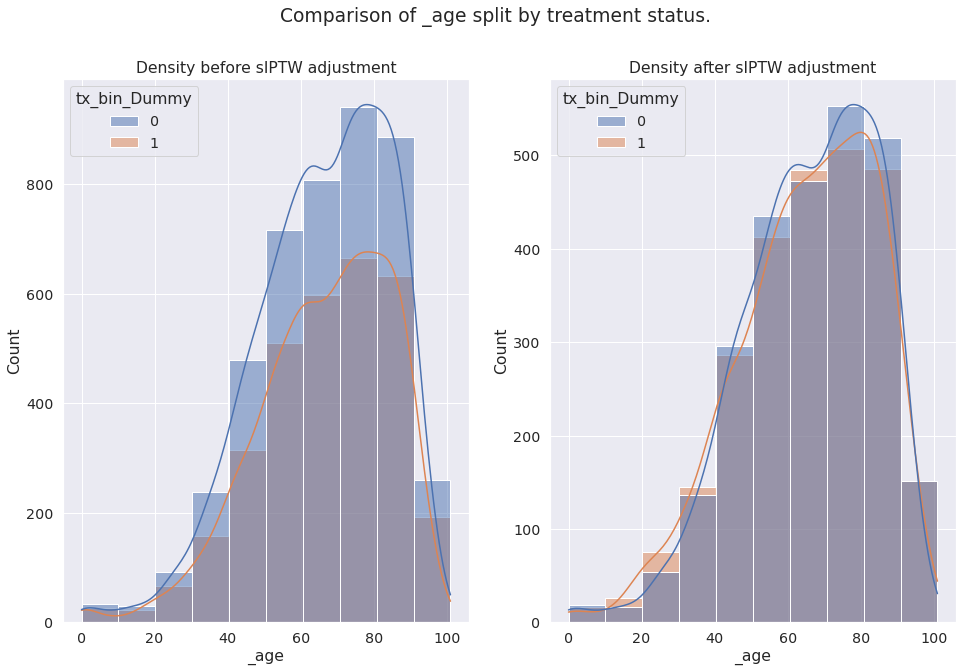

`bins` cannot be 'auto' when using weights. Setting `bins=10`, but you will likely want to adjust.


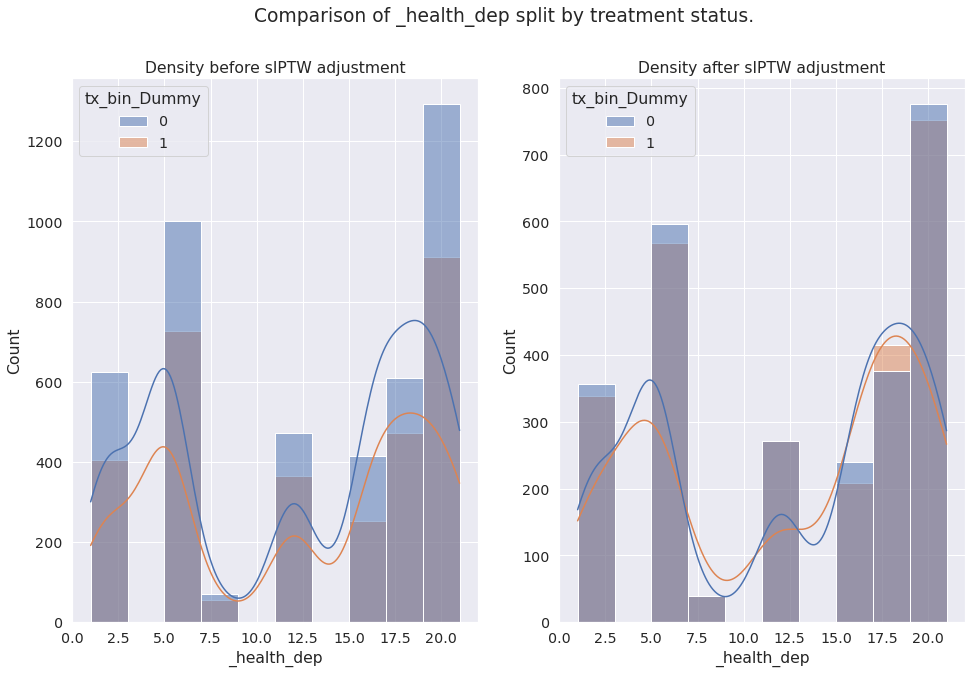

`bins` cannot be 'auto' when using weights. Setting `bins=10`, but you will likely want to adjust.


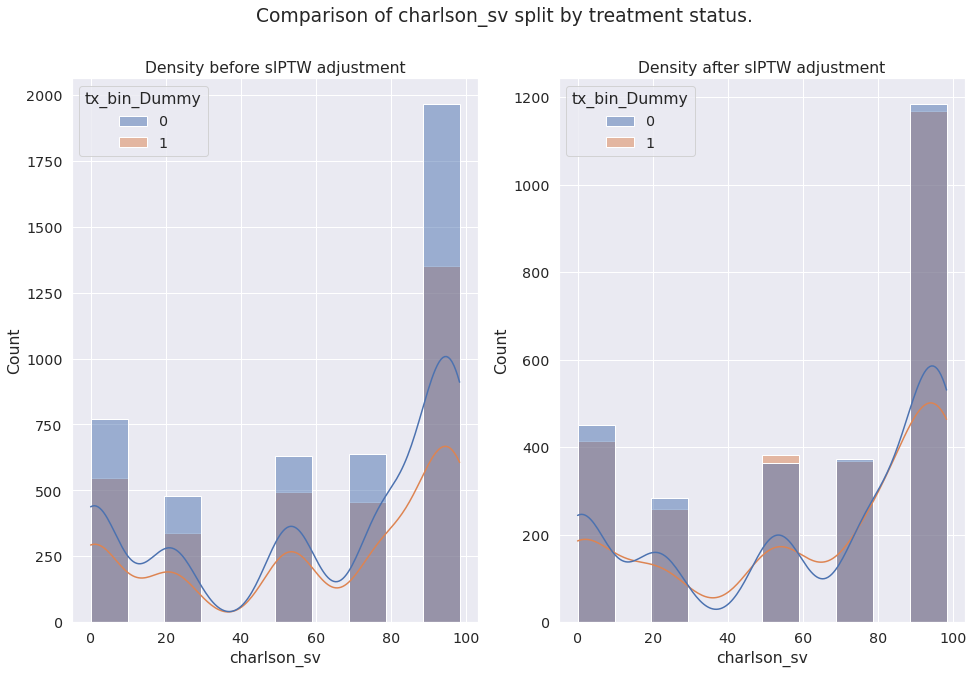

In [366]:
import matplotlib.pyplot as plt
#plt.style.use('classic')
%matplotlib inline

import seaborn as sns
sns.set(rc={'figure.figsize':(16,10)}, font_scale=1.3)
args = ['_age','_health_dep', 'charlson_sv']
Y = ex.apply(lambda x: False if (x.dead == True) and  (x.readmission == True) else x['dead'] ,axis = 1)  #do not count as dead if the event belong to a future readmission 
    
def plot(arg):
    fig, ax = plt.subplots(1,2)
    fig.suptitle('Comparison of {} split by treatment status.'.format(arg))
    
    sns.histplot(data = ex, bins = 10, x = arg, hue = f'tx_bin_{tt}',  ax = ax[0] ,  kde = True).set(title='Density before sIPTW adjustment')
    sns.histplot(data = ex, x = arg, hue = f'tx_bin_{tt}',  ax = ax[1] , weights = 'sIPTW', kde = True).set(title='Density after sIPTW adjustment')
    plt.show()
    fig.savefig(f"{tt}_{arg}_comparison.png")

for arg in args:
    plot(arg)

In [367]:
list(zip(y_val,p_val))[:10]

[(0, array([0.7940926, 0.2059074])),
 (1, array([0.79615596, 0.20384404])),
 (1, array([0.69942378, 0.30057622])),
 (0, array([0.94882636, 0.05117364])),
 (0, array([0.65079906, 0.34920094])),
 (0, array([0.75080481, 0.24919519])),
 (0, array([0.63129781, 0.36870219])),
 (0, array([0.73025898, 0.26974102])),
 (0, array([0.47368568, 0.52631432])),
 (0, array([0.78837372, 0.21162628]))]

In [368]:
from catboost.utils import eval_metric
from math import log

labels = False
probabilites = False

val = True
if val:
    labels = y_val[:]

    probabilities = p_val[:,1]
#else: 
   # labels = y_test[:,0]
    
   # probabilities = p_test[:,1]
    
print(labels.shape)
print(probabilities.shape)

# In binary classification it is necessary to apply the logit function
# to the probabilities to get approxes.

logit = lambda x: log(x / (1 - x))
approxes = list(map(logit, probabilities))

accuracy = eval_metric(labels, approxes, 'Kappa')
accuracy

(1535,)
(1535,)


[0.022189785273058815]

In [369]:
importances = model.get_feature_importance(data=None,
                       type=EFstrType.FeatureImportance,
                       prettified=True,
                       thread_count=-1,
                       verbose=False)

In [370]:
model.calc_feature_statistics(X_train, y_train, feature = 'lab_basal_FOS', plot = True)

{'borders': array([], dtype=float32),
 'binarized_feature': array([], dtype=int64),
 'mean_target': array([], dtype=float32),
 'mean_weighted_target': array([], dtype=float32),
 'mean_prediction': array([], dtype=float32),
 'objects_per_bin': array([], dtype=uint32),
 'predictions_on_varying_feature': array([], dtype=float64)}

In [371]:
importances[:50]

,Feature Id,Importances
0,vs_day_2_sbp,1.756359
1,vs_basal_sbp,1.648803
2,lab_day_1_LIN,1.603402
3,lab_day_1_POT,1.405836
4,vs_day_2_tem,1.336066
5,vs_day_1_heart_rate,1.289358
6,lab_day_1_Hem,1.280663
7,vs_day_2_dbp,1.268836
8,vs_basal_dbp,1.264593
9,lab_day_2_GOT,1.257278


In [372]:
import shap

In [373]:
# explain the model's predictions using SHAP
# (same syntax works for LightGBM, CatBoost, scikit-learn, transformers, Spark, etc.)
explainer = shap.Explainer(model)
shap_values = explainer(X)

In [374]:
#shap_values

In [375]:
y[10]

array([1])

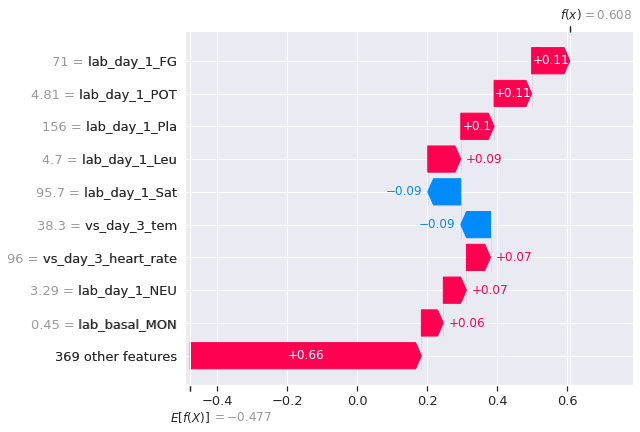

100.400748502994

In [376]:
# visualize the first prediction's explanation
shap.plots.waterfall(shap_values[10])
ex['lab_day_1_CLO'].mean()

In [377]:
# visualize the first prediction's explanation with a force plot
shap.initjs()
shap.plots.force(shap_values[10])

In [378]:
pd.DataFrame( {'feature' : X.columns.values, 'value' : shap_values[10].data})[:10]

,feature,value
0,1Diabetes,0.0
1,2Diabetes,1.0
2,ARDS,0.0
3,Acute_bronchitis,0.0
4,Acute_kidney,0.0
5,CNS_cognitive,0.0
6,CNS_ischemia,0.0
7,Cardiovascular,0.0
8,Covid_pneumonia,True
9,Covid_rel_dx_binary,1


In [379]:
# visualize all the training set predictions
shap.initjs()
shap.plots.force(explainer.expected_value, shap_values.values[:500], feature_names = X.columns)

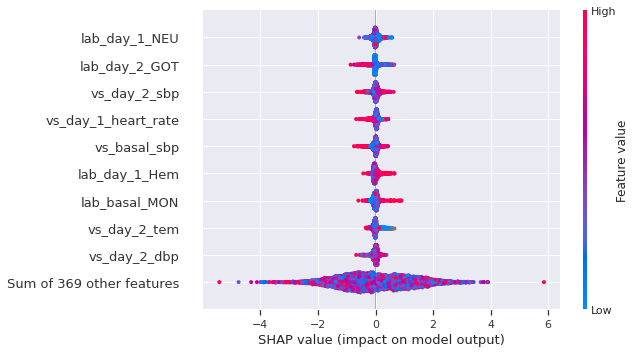

In [380]:
shap.plots.beeswarm(shap_values)

In [382]:
# create a dependence scatter plot to show the effect of a single feature across the whole dataset
shap.initjs()
#shap.plots.scatter(shap_values[:,'charlson_sv'], color=shap_values)

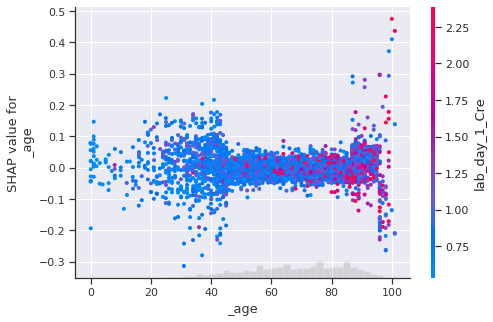

In [383]:
shap.plots.scatter(shap_values[:,'_age'], color=shap_values)

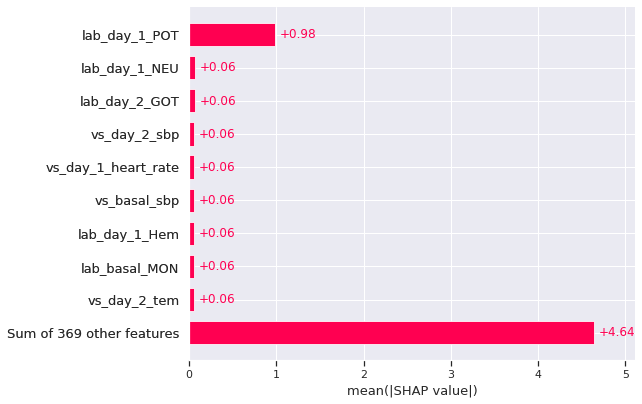

In [384]:
shap.plots.bar(shap_values)

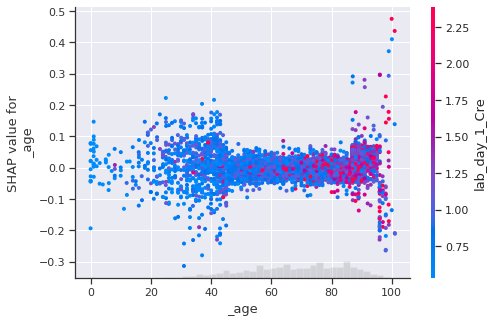

In [385]:
shap.plots.scatter(shap_values[:,'_age'], color=shap_values)

In [386]:
interactions = model.get_feature_importance(data=None,
                       type=EFstrType.Interaction,
                       prettified=True,
                       thread_count=-1,
                       verbose=False)

In [387]:
interactions['First Feature'] = interactions['First Feature Index'].apply(lambda x: x_vars[x])
interactions['Second Feature'] = interactions['Second Feature Index'].apply(lambda x: x_vars[x])

In [388]:
interactions[['First Feature', 'Second Feature', 'Interaction']].iloc[:10]

,First Feature,Second Feature,Interaction
0,lab_basal_Pla,vs_day_2_sbp,0.230573
1,lab_day_2_GOT,lab_day_2_GPT,0.228126
2,lab_day_1_GPT,lab_day_1_Pla,0.220653
3,lab_basal_Tra,vs_basal_sbp,0.192673
4,lab_day_1_Leu,lab_day_1_NEU,0.188667
5,lab_day_2_CAL,lab_day_2_GGT,0.186808
6,cx_res_basal_resp_rate,lab_day_3_TRO,0.183946
7,lab_day_1_NEU,lab_day_2_PRO,0.180629
8,lab_day_1_MON,vs_basal_sbp,0.177830
9,lab_basal_PCR,vs_basal_sbp,0.175006


In [389]:
#shap.dependence_plot("date_in", shap_values.values, X, interaction_index= 'charlson_sv')

In [390]:
#shap.dependence_plot("date_in", shap_values.values, X, interaction_index= '_age')

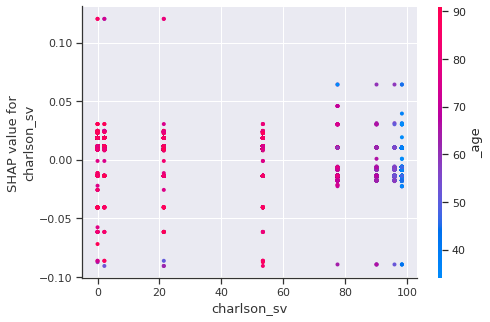

In [391]:
shap.dependence_plot("charlson_sv", shap_values.values, X, interaction_index= '_age')

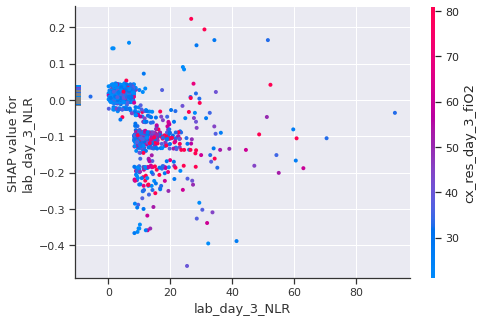

In [392]:
shap.dependence_plot("lab_day_3_NLR", shap_values.values, X, interaction_index= 'cx_res_day_3_fiO2')

from pathlib import Path
path_rx = Path('../Rx-thorax-automatic-captioning')
img_labels = pd.read_csv(path_rx /'Labels_covid_pharma.csv')[['PatientID','ReportID','Report','Labels', 'LabelsLocalizationsBySentence', 'labelCUIS', 'LocalizationsCUIS']]
img_labels['_health_dep'] = img_labels.ReportID.apply(lambda x: x.split('_')[0])
img_labels['_date'] = img_labels.ReportID.apply(lambda x: x.split('_')[-1])
img_labels['_modality'] = img_labels.ReportID.apply(lambda x: x.split('_')[-2])
img_labels.drop(columns = ['ReportID'], inplace = True)

img_labels[img_labels._health_dep == '20'].to_csv('Rx_20.csv', index = False)


img_labels[img_labels._health_dep == '20'].shape

#### Generate adusted sv curves

In [393]:
from lifelines import KaplanMeierFitter, CoxPHFitter
from lifelines.statistics import logrank_test
import seaborn as sns
import matplotlib.pyplot as plt

suffix_csv = '.csv'
suffix_png = f'.png'

def sv_tx_graph(df_select,tx,  log, adjusted = True, group = np.array([])):
    
    km_df = df_select  
    
    km_df = km_df[(km_df.survival < 600 ) & (km_df.survival >= 0 )]
    print(km_df.shape)
    if group.size == 0:
        group = km_df[f'tx_bin_{tx}'] == True
    else:
        group = km_df.index.isin(group)

    col =  ['charlson','charlson_sv','_age' ]
    d = pd.DataFrame(km_df.groupby(group).describe(), ).sort_index(ascending = False).round(1).loc[:,(col,['mean','std'])]


    kmf = KaplanMeierFitter()
    if log:
        X= km_df['survival'].apply(lambda x: np.log2(x) if x > 0 else x)
    else: 
        X= km_df['survival']
    Y = km_df.apply(lambda x: False if (x.dead == True) and  (x.readmission == True) else x['dead'] ,axis = 1)  #do not count as dead if the event belong to a future readmission 
    #Y = km_df['dead']
    ax = plt.subplot(111)
    if adjusted: 
        kmf.fit(X[group], event_observed = Y[group], label = f'{tx} (n {X[group].shape[0]}, Age {d[["_age"]].iloc[0].values[0]}y)',
               weights = km_df[group].sIPTW)
        kmf.plot(ax = ax)
        kmf.fit(X[~group], event_observed = Y[~group], label = f'No {tx} (n {X[~group].shape[0]}, Age {d[["_age"]].iloc[1].values[0]}y)',
               weights = km_df[~group].sIPTW)
        kmf.plot(ax = ax)
    else: 
        kmf.fit(X[group], event_observed = Y[group], label = f'{tx} (n {X[group].shape[0]}, Age {d[["_age"]].iloc[0].values[0]}y)',
               )
        kmf.plot(ax = ax)
        kmf.fit(X[~group], event_observed = Y[~group], label = f'No {tx} (n {X[~group].shape[0]}, Age {d[["_age"]].iloc[1].values[0]}y)',
               )
        kmf.plot(ax = ax)
    
    plt.title("Kaplan Meier estimates")
    plt.xlabel("Days after admission")
    plt.ylabel("Survival")
    plt.legend(fontsize = 'x-small')
    if log:
        plt.xticks([0,2,4,6,8],[0,4,16,64,256])

    if log: 
        plt.savefig(f'out_EDA/STATS/adjusted_{adjusted}_KM_sv_{tx}_log_scaled_{suffix_png}')
    else: 
        plt.savefig(f'out_EDA/STATS/adjusted__{adjusted}_KM_sv_{tx}_{suffix_png}')
    #plt.show()
    
    
    # Define variables :
    T=X[group]
    E=Y[group]
    T1=X[~group]
    E1=Y[~group]

    from lifelines.statistics import logrank_test

    results=logrank_test(T,T1,event_observed_A=E, event_observed_B=E1)
    results.print_summary()
    
    
    from lifelines import CoxPHFitter

    #df = km_df[['survival','dead','sIPTW',f'tx_bin_{tx}','charlson_sv', '_age']]
    df = km_df[['survival','dead','sIPTW',f'tx_bin_{tx}']]

    cph = CoxPHFitter()
    if adjusted:
        cph.fit(df, 'survival', 'dead',  robust=True, weights_col='sIPTW')
    else:
        cph.fit(df.drop(['sIPTW'], axis = 1), 'survival', 'dead',  robust=True,)
    cph.print_summary()
    return

(7669, 1087)


<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           2.46 0.12      3.10

<lifelines.CoxPHFitter: fitted with 7669 total observations, 6325 right-censored observations>
             duration col = 'survival'
                event col = 'dead'
          robust variance = True
      baseline estimation = breslow
   number of observations = 7669
number of events observed = 1344
   partial log-likelihood = -11416.49
         time fit was run = 2021-06-14 14:17:45 UTC

---
               coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                            
tx_bin_Dummy   0.08       1.09       0.06            -0.03             0.19                 0.97                 1.21

                z    p   -log2(p)
covariate                        
tx_bin_Dummy 1.49 0.14       2.88
---
Concordance = 0.51
Partial AIC = 22834.98
log-likelihood ratio test = 2.21 on 1 df
-log2(p) of ll-ratio test = 2.87

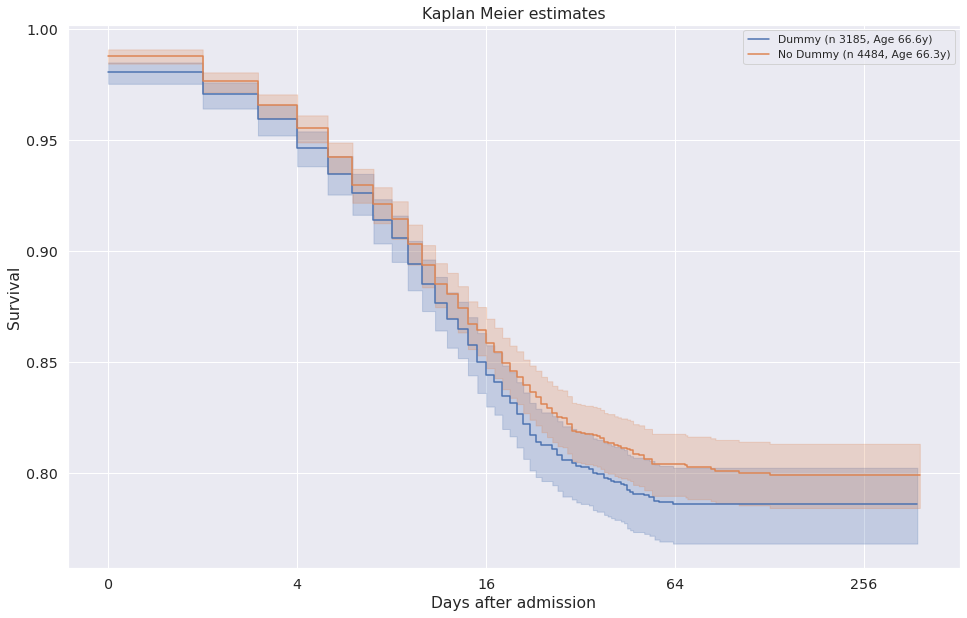

In [394]:
sv_tx_graph(ex, tt, log = True, adjusted = False )


(7669, 1087)


It looks like your weights are not integers, possibly propensity scores then?
  It's important to know that the naive variance estimates of the coefficients are biased. Instead use Monte Carlo to
  estimate the variances. See paper "Variance estimation when using inverse probability of treatment weighting (IPTW) with survival analysis"
  or "Adjusted Kaplan-Meier estimator and log-rank test with inverse probability of treatment weighting for survival data."
                  
It looks like your weights are not integers, possibly propensity scores then?
  It's important to know that the naive variance estimates of the coefficients are biased. Instead use Monte Carlo to
  estimate the variances. See paper "Variance estimation when using inverse probability of treatment weighting (IPTW) with survival analysis"
  or "Adjusted Kaplan-Meier estimator and log-rank test with inverse probability of treatment weighting for survival data."
                  


<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           2.46 0.12      3.10

<lifelines.CoxPHFitter: fitted with 5242.1 total observations, 4349.06 right-censored observations>
             duration col = 'survival'
                event col = 'dead'
              weights col = 'sIPTW'
          robust variance = True
      baseline estimation = breslow
   number of observations = 5242.1
number of events observed = 893.038
   partial log-likelihood = -7251.14
         time fit was run = 2021-06-14 14:17:49 UTC

---
               coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                            
tx_bin_Dummy   0.11       1.12       0.07            -0.03             0.25                 0.97                 1.29

                z    p   -log2(p)
covariate                        
tx_bin_Dummy 1.50 0.13       2.90
---
Concordance = 0.51
Partial AIC = 14504.28
log-likelihood ratio test = 2.70 on 1 df
-log2(p) of ll-ratio test = 3.32

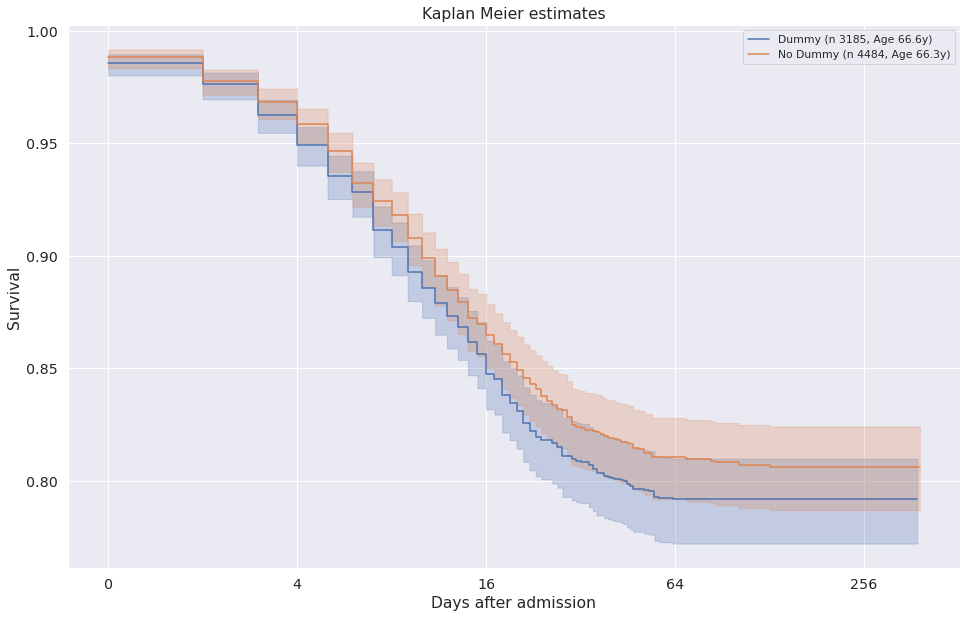

In [395]:
sv_tx_graph(ex, tt, log = True, adjusted = True )

### Re-estimates the outcome model using these new weight sIPTW

#### Outcome: AUC of the models for predicting mortality conditioned on treatment as a binomial outcome treatment responsiveness was predicted through a binomial logistic objective that was used for predicting positive class (improved disease if treated vs worsened disease if not treated) and negative class (worsened disease if treated vs improved disease if not treated). For our purposes, improved disease was defined as a last recorded oxygen saturation of ≥95%, or survival (defined as discharged alive), and worsened disease was defined as a last recorded oxygen saturation of < 95%, or death.

#### Design improvement - No response to treatment outcome based in who scale: 1, not hospitalized with resumption of normal activities; 2, not hospitalized, but unable to resume normal activities; 3, hospitalized, not requiring supplemental oxygen; 4, hospitalized, requiring supplemental oxygen; 5, hospitalized, requiring nasal high-flow oxygen therapy, noninvasive mechanical ventilation, or both; 6, hospitalized, requiring ECMO, invasive mechanical ventilation, or both; and 7, death. Who >= 4 is a better surrogate of treatment not responsiveness than either satO2 on last day or death as satO2 has not into account if supplemental oxigen. 

In [396]:
ex['y_who'] = 1 #disease improved 
ex.loc[ex.who_last >= 4, ['y_who'] ] = 0
ex.y_who.describe()

count    7671.000000
mean        0.804328
std         0.396743
min         0.000000
25%         1.000000
50%         1.000000
75%         1.000000
max         1.000000
Name: y_who, dtype: float64

In [397]:
ex['y_binomial'] = 1 #disease improved and treated OR disease not improved and not treated 
ex.loc[(ex.y_who == 1) & (ex[f'tx_bin_{tt}'] == 0) , ['y_binomial'] ] = 0 #disease improved and not treated
ex.loc[(ex.y_who == 0) & (ex[f'tx_bin_{tt}']  == 1) , ['y_binomial'] ] = 0 #disease not improved and treated 
ex.y_binomial.describe()

count    7671.000000
mean        0.443880
std         0.496873
min         0.000000
25%         0.000000
50%         0.000000
75%         1.000000
max         1.000000
Name: y_binomial, dtype: float64

In [398]:
y_binomial = ex.y_binomial.values
y_binomial

array([0, 0, 0, ..., 0, 1, 0])

###### Remove all variables beyond 1º day of admission in the training set

In [399]:
outcomes = [x for x in ex.columns.values if any(substring in x for substring in outcome_list)]
outcomes.extend(['cx_res_day_last_satO2', 'who_last','who_array', 'who_bin',  'weight', 'who_day_2'])


In [400]:
outcomes

['critic',
 'severity',
 '_discharge',
 'n_days_to_readmission',
 'dead',
 'survival',
 'survival_uncensored',
 'readmission',
 'readmission_free_survival',
 'sIPTW',
 'y_who',
 'y_binomial',
 'cx_res_day_last_satO2',
 'who_last',
 'who_array',
 'who_bin',
 'weight',
 'who_day_2']

In [401]:
beyond_1_day_list = ['2_','3', '4_', '5_', '6', '7', '8_', '9' ]
beyond_1_day = [x for x in ex.columns.values if any(substring in x for substring in beyond_1_day_list)]
ex[beyond_1_day].head()

,tx_day_2_Anakinra,tx_day_3_Anakinra,tx_day_2_Azitromicina,tx_day_3_Azitromicina,tx_day_2_Baricitinib,tx_day_3_Baricitinib,tx_day_2_Bemiparina,tx_day_3_Bemiparina,tx_day_2_Ciclosporina,tx_day_3_Ciclosporina,tx_day_2_Cloroquina,tx_day_3_Cloroquina,tx_day_2_Corticoides,tx_day_3_Corticoides,tx_day_2_Darunavir_cobicistat,tx_day_3_Darunavir_cobicistat,tx_day_2_Dexametasona,tx_day_3_Dexametasona,tx_day_2_Enoxaparina,tx_day_3_Enoxaparina,tx_day_2_G-CSF,tx_day_3_G-CSF,tx_day_2_Heparina,tx_day_3_Heparina,tx_day_2_Hidroxicloroquina,tx_day_3_Hidroxicloroquina,tx_day_2_Interferon_beta_1a,tx_day_3_Interferon_beta_1a,tx_day_2_Interferon_beta_1b,tx_day_3_Interferon_beta_1b,tx_day_2_Ivermectina,tx_day_3_Ivermectina,tx_day_2_Lopinavir_ritonavir,tx_day_3_Lopinavir_ritonavir,tx_day_2_Metilprednisolona,tx_day_3_Metilprednisolona,tx_day_2_Remdesivir,tx_day_3_Remdesivir,tx_day_2_Ruxolitinib,tx_day_3_Ruxolitinib,tx_day_2_Tacrolimus,tx_day_3_Tacrolimus,tx_day_2_Tiamina_vitamina_B1,tx_day_3_Tiamina_vitamina_B1,tx_day_2_Tocilizumab,tx_day_3_Tocilizumab,tx_day_2_Tofacitinib,tx_day_3_Tofacitinib,tx_day_2_Vitamina_D,tx_day_3_Vitamina_D,tx_day_2_Zinc,tx_day_3_Zinc,cx_res_day_2_satO2,cx_res_day_3_satO2,cx_res_day_4_satO2,cx_res_day_5_satO2,cx_res_day_6_satO2,cx_res_day_7_satO2,cx_res_day_2_fiO2,cx_res_day_3_fiO2,cx_res_day_4_fiO2,cx_res_day_5_fiO2,cx_res_day_6_fiO2,cx_res_day_7_fiO2,cx_res_day_2_resp_rate,cx_res_day_3_resp_rate,cx_res_day_4_resp_rate,cx_res_day_5_resp_rate,cx_res_day_6_resp_rate,cx_res_day_7_resp_rate,cx_res_day_2_SF_ratio,cx_res_day_3_SF_ratio,cx_res_day_4_SF_ratio,cx_res_day_5_SF_ratio,cx_res_day_6_SF_ratio,cx_res_day_7_SF_ratio,vs_day_2_sbp,vs_day_3_sbp,vs_day_4_sbp,vs_day_5_sbp,vs_day_6_sbp,vs_day_7_sbp,vs_day_2_tem,vs_day_3_tem,vs_day_4_tem,vs_day_5_tem,vs_day_6_tem,vs_day_7_tem,vs_day_2_heart_rate,vs_day_3_heart_rate,vs_day_4_heart_rate,vs_day_5_heart_rate,vs_day_6_heart_rate,vs_day_7_heart_rate,vs_day_2_dbp,vs_day_3_dbp,vs_day_4_dbp,vs_day_5_dbp,vs_day_6_dbp,vs_day_7_dbp,lab_day_2_25,lab_day_3_25,lab_day_4_25,lab_day_5_25,lab_day_6_25,lab_day_7_25,lab_day_2_ALB,lab_day_3_ALB,lab_day_4_ALB,lab_day_5_ALB,lab_day_6_ALB,lab_day_7_ALB,lab_day_2_BNP,lab_day_3_BNP,lab_day_4_BNP,lab_day_5_BNP,lab_day_6_BNP,lab_day_7_BNP,lab_day_2_Bic,lab_day_3_Bic,lab_day_4_Bic,lab_day_5_Bic,lab_day_6_Bic,lab_day_7_Bic,lab_day_2_Bil,lab_day_3_Bil,lab_day_4_Bil,lab_day_5_Bil,lab_day_6_Bil,lab_day_7_Bil,lab_day_2_CAL,lab_day_3_CAL,lab_day_4_CAL,lab_day_5_CAL,lab_day_6_CAL,lab_day_7_CAL,lab_day_2_CLO,lab_day_3_CLO,lab_day_4_CLO,lab_day_5_CLO,lab_day_6_CLO,lab_day_7_CLO,lab_day_2_CO2,lab_day_3_CO2,lab_day_4_CO2,lab_day_5_CO2,lab_day_6_CO2,lab_day_7_CO2,lab_day_2_CPK,lab_day_3_CPK,lab_day_4_CPK,lab_day_5_CPK,lab_day_6_CPK,lab_day_7_CPK,lab_day_2_Cre,lab_day_3_Cre,lab_day_4_Cre,lab_day_5_Cre,lab_day_6_Cre,lab_day_7_Cre,lab_day_2_Dim,lab_day_3_Dim,lab_day_4_Dim,lab_day_5_Dim,lab_day_6_Dim,lab_day_7_Dim,lab_day_2_ERI,lab_day_3_ERI,lab_day_4_ERI,lab_day_5_ERI,lab_day_6_ERI,lab_day_7_ERI,lab_day_2_Exc,lab_day_3_Exc,lab_day_4_Exc,lab_day_5_Exc,lab_day_6_Exc,lab_day_7_Exc,lab_day_2_FG,lab_day_3_FG,lab_day_4_FG,lab_day_5_FG,lab_day_6_FG,lab_day_7_FG,lab_day_2_FIL,lab_day_3_FIL,lab_day_4_FIL,lab_day_5_FIL,lab_day_6_FIL,lab_day_7_FIL,lab_day_2_FOS,lab_day_3_FOS,lab_day_4_FOS,lab_day_5_FOS,lab_day_6_FOS,lab_day_7_FOS,lab_day_2_Fer,lab_day_3_Fer,lab_day_4_Fer,lab_day_5_Fer,lab_day_6_Fer,lab_day_7_Fer,lab_day_2_FiO,lab_day_3_FiO,lab_day_4_FiO,lab_day_5_FiO,lab_day_6_FiO,lab_day_7_FiO,lab_day_2_Fib,lab_day_3_Fib,lab_day_4_Fib,lab_day_5_Fib,lab_day_6_Fib,lab_day_7_Fib,lab_day_2_GGT,lab_day_3_GGT,lab_day_4_GGT,lab_day_5_GGT,lab_day_6_GGT,lab_day_7_GGT,lab_day_2_GLU,lab_day_3_GLU,lab_day_4_GLU,lab_day_5_GLU,lab_day_6_GLU,lab_day_7_GLU,lab_day_2_GOT,lab_day_3_GOT,lab_day_4_GOT,lab_day_5_GOT,lab_day_6_GOT,lab_day_7_GOT,lab_day_2_GPT,lab_day_3_GPT,lab_day_4_GPT,lab_day_5_GPT,lab_day_6_GPT,lab_day_7_GPT,lab_day_2_HEM,lab_day_3_HEM,lab_day_4_HEM,lab_day_5_HEM,lab_day_6_HEM,lab_day_7_H

In [402]:
pd.set_option('display.max_columns', None)
#ex.head()

In [403]:
ex['cx_res_day_last_satO2'].describe()

count    7521.000000
mean       93.504619
std         6.994174
min         0.500000
25%        93.000000
50%        95.000000
75%        97.000000
max       100.000000
Name: cx_res_day_last_satO2, dtype: float64

In [404]:
x_vars = list(set(ex.columns.values) - set(['date_in','_health_dep'])  - set(beyond_1_day) - set(icu)  - set(leak_tx_effect) - set(outcomes) - set(leak_temp) - set(drop) - set(drop1))
x_vars.sort()
x_vars

['1Diabetes',
 '2Diabetes',
 'ARDS',
 'Acute_bronchitis',
 'Acute_kidney',
 'CNS_cognitive',
 'CNS_ischemia',
 'Cardiovascular',
 'Covid_pneumonia',
 'Covid_rel_dx_binary',
 'Covid_respiratory_interst',
 'Covid_respiratory_other',
 'Covid_respiratory_pneu',
 'Covid_respiratory_pneu_other',
 'Covid_respiratory_upp',
 'Cytokine_RS',
 'Disseminated_IC',
 'Enteritis',
 'Heart_disease',
 'Hypertension',
 'Hypogluc',
 'Hypogluc_grade',
 'Immunocompromised',
 'Inflammatory_R',
 'Lipemias',
 'Liver',
 'Lung_Embolism',
 'Malignancy',
 'Obesity',
 'Renal',
 'Respiratory',
 'Second_pneumonia',
 'Tobacco',
 'Venous_Thrombosis',
 '_age',
 '_gender',
 'barthel_scale',
 'charlson',
 'charlson_sv',
 'covid_rel_image',
 'cx_res_basal_SF_ratio',
 'cx_res_basal_fiO2',
 'cx_res_basal_resp_rate',
 'cx_res_basal_satO2',
 'cx_res_day_1_SF_ratio',
 'cx_res_day_1_fiO2',
 'cx_res_day_1_resp_rate',
 'cx_res_day_1_satO2',
 'height',
 'index',
 'lab_basal_25',
 'lab_basal_ALB',
 'lab_basal_BNP',
 'lab_basal_Bic',


In [405]:
X = ex[x_vars]
X.head()

,1Diabetes,2Diabetes,ARDS,Acute_bronchitis,Acute_kidney,CNS_cognitive,CNS_ischemia,Cardiovascular,Covid_pneumonia,Covid_rel_dx_binary,Covid_respiratory_interst,Covid_respiratory_other,Covid_respiratory_pneu,Covid_respiratory_pneu_other,Covid_respiratory_upp,Cytokine_RS,Disseminated_IC,Enteritis,Heart_disease,Hypertension,Hypogluc,Hypogluc_grade,Immunocompromised,Inflammatory_R,Lipemias,Liver,Lung_Embolism,Malignancy,Obesity,Renal,Respiratory,Second_pneumonia,Tobacco,Venous_Thrombosis,_age,_gender,barthel_scale,charlson,charlson_sv,covid_rel_image,cx_res_basal_SF_ratio,cx_res_basal_fiO2,cx_res_basal_resp_rate,cx_res_basal_satO2,cx_res_day_1_SF_ratio,cx_res_day_1_fiO2,cx_res_day_1_resp_rate,cx_res_day_1_satO2,height,index,lab_basal_25,lab_basal_ALB,lab_basal_BNP,lab_basal_Bic,lab_basal_Bil,lab_basal_CAL,lab_basal_CLO,lab_basal_CO2,lab_basal_CPK,lab_basal_Cre,lab_basal_Dim,lab_basal_ERI,lab_basal_Exc,lab_basal_FG,lab_basal_FIL,lab_basal_FOS,lab_basal_Fer,lab_basal_FiO,lab_basal_Fib,lab_basal_GGT,lab_basal_GLU,lab_basal_GOT,lab_basal_GPT,lab_basal_HEM,lab_basal_Hem,lab_basal_IL,lab_basal_K_o,lab_basal_LDH,lab_basal_LIN,lab_basal_Leu,lab_basal_MAG,lab_basal_MON,lab_basal_NEU,lab_basal_NLR,lab_basal_PCR,lab_basal_POT,lab_basal_PRO,lab_basal_Pla,lab_basal_Prc,lab_basal_Pre,lab_basal_SBE,lab_basal_SOD,lab_basal_Sat,lab_basal_T4,lab_basal_T8,lab_basal_TRO,lab_basal_TTP,lab_basal_Tra,lab_basal_URE,lab_basal_glu_cv,lab_basal_pCO,lab_basal_pH,lab_basal_pO2,lab_day_1_25,lab_day_1_ALB,lab_day_1_BNP,lab_day_1_Bic,lab_day_1_Bil,lab_day_1_CAL,lab_day_1_CLO,lab_day_1_CO2,lab_day_1_CPK,lab_day_1_Cre,lab_day_1_Dim,lab_day_1_ERI,lab_day_1_Exc,lab_day_1_FG,lab_day_1_FIL,lab_day_1_FOS,lab_day_1_Fer,lab_day_1_FiO,lab_day_1_Fib,lab_day_1_GGT,lab_day_1_GLU,lab_day_1_GOT,lab_day_1_GPT,lab_day_1_HEM,lab_day_1_Hem,lab_day_1_IL,lab_day_1_K_o,lab_day_1_LDH,lab_day_1_LIN,lab_day_1_Leu,lab_day_1_MAG,lab_day_1_MON,lab_day_1_NEU,lab_day_1_NLR,lab_day_1_PCR,lab_day_1_POT,lab_day_1_PRO,lab_day_1_Pla,lab_day_1_Prc,lab_day_1_Pre,lab_day_1_SBE,lab_day_1_SOD,lab_day_1_Sat,lab_day_1_T4,lab_day_1_T8,lab_day_1_TRO,lab_day_1_TTP,lab_day_1_Tra,lab_day_1_URE,lab_day_1_glu_cv,lab_day_1_pCO,lab_day_1_pH,lab_day_1_pO2,micro,tx_day_1_Anakinra,tx_day_1_Azitromicina,tx_day_1_Baricitinib,tx_day_1_Bemiparina,tx_day_1_Ciclosporina,tx_day_1_Cloroquina,tx_day_1_Corticoides,tx_day_1_Darunavir_cobicistat,tx_day_1_Dexametasona,tx_day_1_Enoxaparina,tx_day_1_G-CSF,tx_day_1_Heparina,tx_day_1_Hidroxicloroquina,tx_day_1_Interferon_beta_1a,tx_day_1_Interferon_beta_1b,tx_day_1_Ivermectina,tx_day_1_Lopinavir_ritonavir,tx_day_1_Metilprednisolona,tx_day_1_Remdesivir,tx_day_1_Ruxolitinib,tx_day_1_Tacrolimus,tx_day_1_Tiamina_vitamina_B1,tx_day_1_Tocilizumab,tx_day_1_Tofacitinib,tx_day_1_Vitamina_D,tx_day_1_Zinc,vs_basal_dbp,vs_basal_heart_rate,vs_basal_sbp,vs_basal_tem,vs_day_1_dbp,vs_day_1_heart_rate,vs_day_1_sbp,vs_day_1_tem,who_day_1
1,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,True,1,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64.0,woman,NaN,3.0,77.5,1,321.0,29.0,32.0,93.0,321.0,29.0,36.0,93.0,NaN,0,NaN,NaN,NaN,26.3,NaN,NaN,106.5,NaN,135.0,0.70,1500.17,5.30,3.7,84.0,84.0,NaN,1149.0,NaN,558.60,NaN,240.0,22.1,25.7,NaN,15.3,NaN,NaN,347.0,1.46,16.78,NaN,0.92,14.31,9.80,93.7,3.99,NaN,422.0,0.15,NaN,NaN,145.7,95.3,NaN,NaN,NaN,24.9,NaN,70.0,NaN,34.7,7.49,67.7,NaN,NaN,NaN,26.3,NaN,NaN,106.5,NaN,135.0,0.70,1500.17,5.30,3.70,84.0,84.0,NaN,1149.0,NaN,558.60,NaN,240.0,22.1,25.70,NaN,15.3,NaN,NaN,347.0,1.46,16.78,NaN,0.92,14.31,9.80,93.70,3.99,NaN,422.0,0.15,NaN,NaN,145.7,95.3,NaN,NaN,NaN,24.9,NaN,70.0,15.39,34.7,7.49,67.7,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,110.0,141.0,138.0,36.6,78.0,141.0,126.0,36.6,3
2,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,False,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,80.0,man,NaN,9.0,0.0,1,405.0,21.0,34.0,85.0,230.0,37.0,34.0

In [406]:
### Cross Validation



cv_dataset = Pool(data = X[x_vars], 
                 label = y_binomial,
                 weight = sIPTW,
                 cat_features=['_gender'])


params = {"iterations": 50,
          "depth": 6,
          'learning_rate' : 0.3,
          "loss_function": "CrossEntropy",
          "eval_metric": "AUC",
          "verbose": False}

scores = cv(cv_dataset,
            params,
            fold_count=10, 
            plot="True")

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [407]:
### Non- CV - Best Model
health_dep_test = [17,19]
X_test = ex.loc[(ex._health_dep.isin(health_dep_test)), x_vars + ['sIPTW']]
y_test = ex.loc[(ex._health_dep.isin(health_dep_test)), 'y_binomial'].values


X = ex.loc[(ex._health_dep.isin(health_dep_test) == False),x_vars + ['sIPTW']]
y_binomial  = ex.loc[(ex._health_dep.isin(health_dep_test) == False),'y_binomial'].values



from sklearn.model_selection import train_test_split
X_train, X_val, y_train, y_val = train_test_split(
    X, y_binomial, test_size=0.20, random_state=42)

print(X_train.shape, y_train.shape, X_val.shape, y_val.shape, X_test.shape, y_test.shape, )


(4483, 193) (4483,) (1121, 193) (1121,) (2067, 193) (2067,)


In [408]:
ex[x_vars[-56:-36]].head()

,lab_day_1_NLR,lab_day_1_PCR,lab_day_1_POT,lab_day_1_PRO,lab_day_1_Pla,lab_day_1_Prc,lab_day_1_Pre,lab_day_1_SBE,lab_day_1_SOD,lab_day_1_Sat,lab_day_1_T4,lab_day_1_T8,lab_day_1_TRO,lab_day_1_TTP,lab_day_1_Tra,lab_day_1_URE,lab_day_1_glu_cv,lab_day_1_pCO,lab_day_1_pH,lab_day_1_pO2
1,9.80,93.70,3.99,NaN,422.0,0.15,NaN,NaN,145.7,95.3,NaN,NaN,NaN,24.9,NaN,70.0,15.39,34.7,7.49,67.7
2,3.05,9.55,3.70,6.0,297.5,NaN,NaN,1.25,135.0,NaN,NaN,NaN,NaN,NaN,NaN,260.5,15.38,39.1,7.42,NaN
3,2.10,91.40,3.55,NaN,93.0,NaN,NaN,NaN,142.3,85.9,NaN,NaN,NaN,NaN,NaN,58.0,NaN,41.0,7.42,50.3
6,9.97,149.20,3.61,NaN,100.0,NaN,NaN,NaN,140.3,91.5,NaN,NaN,NaN,28.5,NaN,49.0,NaN,28.7,7.47,57.5
7,4.23,2.80,3.02,NaN,323.0,0.07,NaN,NaN,147.8,97.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31.6,7.51,88.9


In [409]:


#initialize Pool
train_pool = Pool(X_train[x_vars ], 
                  y_train, 
                  weight = X_train.sIPTW,
                  cat_features=['_gender'])
val_pool = Pool(X_val[x_vars], 
                y_val, 
                weight = X_val.sIPTW,
                cat_features=['_gender'])

test_pool = Pool(X_test[x_vars ], 
                y_test, 
                weight = X_test.sIPTW,
                cat_features=['_gender'])

# specify the training parameters 
model = CatBoostClassifier(depth=6, 
                          iterations = 1000,
                          learning_rate=0.3, 
                          loss_function='CrossEntropy', 
                          eval_metric='AUC'
                          )
#train the model
#early_stopping_rounds=20, 
model.fit(train_pool, eval_set=val_pool, plot = True, verbose = False, use_best_model=True)


print(model.get_best_iteration())

print(model.get_all_params())
best_score = model.get_best_score()
print(best_score)
best_score['validation']['AUC']
auc = best_score['validation']['AUC']


model.save_model(f'ex_{tt}_recommender_AUC={auc}',
           format="cbm",
           export_parameters=None,
           pool=train_pool)

p_val = model.predict(val_pool, 
        prediction_type='Probability',
        ntree_start=0, 
        ntree_end=0, 
        thread_count=-1,
        verbose=None)

p_test = model.predict(test_pool, 
        prediction_type='Probability',
        ntree_start=0, 
        ntree_end=0, 
        thread_count=-1,
        verbose=None)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

2
{'nan_mode': 'Min', 'eval_metric': 'AUC', 'combinations_ctr': ['Borders:CtrBorderCount=15:CtrBorderType=Uniform:TargetBorderCount=1:TargetBorderType=MinEntropy:Prior=0/1:Prior=0.5/1:Prior=1/1', 'Counter:CtrBorderCount=15:CtrBorderType=Uniform:Prior=0/1'], 'iterations': 1000, 'sampling_frequency': 'PerTree', 'fold_permutation_block': 0, 'leaf_estimation_method': 'Newton', 'counter_calc_method': 'SkipTest', 'grow_policy': 'SymmetricTree', 'penalties_coefficient': 1, 'boosting_type': 'Plain', 'model_shrink_mode': 'Constant', 'feature_border_type': 'GreedyLogSum', 'ctr_leaf_count_limit': 18446744073709551615, 'bayesian_matrix_reg': 0.10000000149011612, 'one_hot_max_size': 2, 'l2_leaf_reg': 3, 'random_strength': 1, 'rsm': 1, 'boost_from_average': False, 'max_ctr_complexity': 4, 'model_size_reg': 0.5, 'simple_ctr': ['Borders:CtrBorderCount=15:CtrBorderType=Uniform:TargetBorderCount=1:TargetBorderType=MinEntropy:Prior=0/1:Prior=0.5/1:Prior=1/1', 'Counter:CtrBorderCount=15:CtrBorderType=Unif

In [410]:
list(zip(y_val,p_val))[:10], list(zip(y_test,p_test))[:10]

([(0, array([0.50424817, 0.49575183])),
  (1, array([0.43918896, 0.56081104])),
  (0, array([0.53351258, 0.46648742])),
  (0, array([0.50502319, 0.49497681])),
  (1, array([0.52003261, 0.47996739])),
  (0, array([0.53924675, 0.46075325])),
  (1, array([0.53990062, 0.46009938])),
  (0, array([0.50152794, 0.49847206])),
  (0, array([0.52916783, 0.47083217])),
  (0, array([0.52692426, 0.47307574]))],
 [(0, array([0.50982464, 0.49017536])),
  (0, array([0.54658893, 0.45341107])),
  (0, array([0.48312306, 0.51687694])),
  (0, array([0.54244362, 0.45755638])),
  (0, array([0.53381812, 0.46618188])),
  (1, array([0.52191012, 0.47808988])),
  (0, array([0.52916783, 0.47083217])),
  (1, array([0.58007716, 0.41992284])),
  (1, array([0.55219026, 0.44780974])),
  (0, array([0.54854933, 0.45145067]))])

In [411]:
from catboost.utils import eval_metric
from math import log

labels = y_test
print(labels.shape)
probabilities = p_test[:,1]
print(probabilities.shape)

val = False
if val:
    labels = y_val[:,0]

    probabilities = p_val[:,1]


# In binary classification it is necessary to apply the logit function
# to the probabilities to get approxes.

logit = lambda x: log(x / (1 - x))
approxes = list(map(logit, probabilities))

accuracy = eval_metric(labels, approxes, 'AUC')
accuracy

(2067,)
(2067,)


[0.5033752217229631]

In [412]:
importances = model.get_feature_importance(data=None,
                       type=EFstrType.FeatureImportance,
                       prettified=True,
                       thread_count=-1,
                       verbose=False)

In [413]:
importances[:20]

,Feature Id,Importances
0,lab_basal_glu_cv,16.145321
1,vs_day_1_heart_rate,7.761722
2,lab_basal_MON,7.547257
3,vs_basal_tem,7.494121
4,lab_day_1_LDH,6.436634
5,lab_day_1_MON,6.290098
6,lab_basal_LDH,5.490875
7,lab_day_1_LIN,5.439153
8,vs_basal_sbp,5.415660
9,barthel_scale,5.311335


In [414]:
interactions = model.get_feature_importance(data=None,
                       type=EFstrType.Interaction,
                       prettified=True,
                       thread_count=-1,
                       verbose=False)

interactions['First Feature'] = interactions['First Feature Index'].apply(lambda x: x_vars[x])
interactions['Second Feature'] = interactions['Second Feature Index'].apply(lambda x: x_vars[x])

interactions[['First Feature', 'Second Feature', 'Interaction']].iloc[:10]

,First Feature,Second Feature,Interaction
0,lab_basal_Prc,lab_day_1_LDH,6.743195
1,lab_basal_LDH,lab_basal_glu_cv,6.056302
2,barthel_scale,lab_day_1_MON,5.585104
3,lab_day_1_FG,lab_day_1_LIN,5.042029
4,lab_basal_glu_cv,lab_day_1_LIN,4.880274
5,lab_day_1_LDH,vs_day_1_heart_rate,4.796364
6,lab_basal_Prc,vs_basal_sbp,4.749723
7,lab_basal_LDH,lab_day_1_FG,4.177145
8,lab_basal_TTP,lab_basal_glu_cv,4.163652
9,lab_basal_glu_cv,lab_day_1_GOT,3.642905


                   feature  value
33       Venous_Thrombosis    0.0
34                    _age   75.0
35                 _gender  woman
36           barthel_scale    NaN
37                charlson    4.0
38             charlson_sv   53.4
39         covid_rel_image      1
40   cx_res_basal_SF_ratio  452.0
41       cx_res_basal_fiO2   21.0
42  cx_res_basal_resp_rate    NaN
43      cx_res_basal_satO2   95.0
44   cx_res_day_1_SF_ratio  443.0
45       cx_res_day_1_fiO2   21.0
46  cx_res_day_1_resp_rate    NaN
47      cx_res_day_1_satO2   93.0
48                  height    NaN


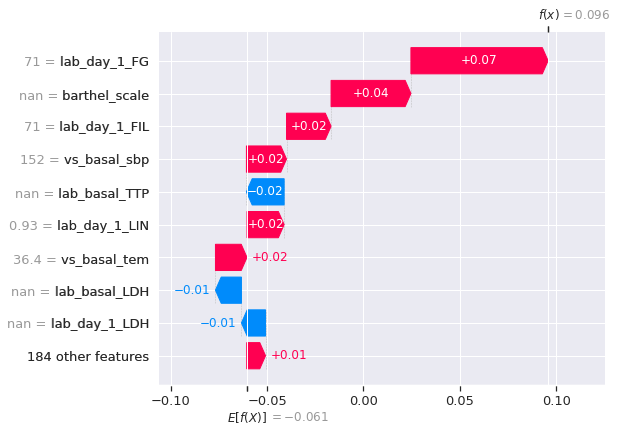

In [415]:
import shap

# explain the model's predictions using SHAP for one patient 
patient = 10
# (same syntax works for LightGBM, CatBoost, scikit-learn, transformers, Spark, etc.)
explainer = shap.Explainer(model)
shap_values = explainer(X)
print(pd.DataFrame( {'feature' : X.columns.values, 'value' : shap_values[patient].data})[33:49])

# visualize the first prediction's explanation
shap.plots.waterfall(shap_values[patient])


In [416]:

# visualize the first prediction's explanation with a force plot
shap.initjs()
shap.plots.force(shap_values[patient])



In [417]:


# visualize all the training set predictions
shap.initjs()
shap.plots.force(explainer.expected_value, shap_values.values[:500], feature_names = X.columns)

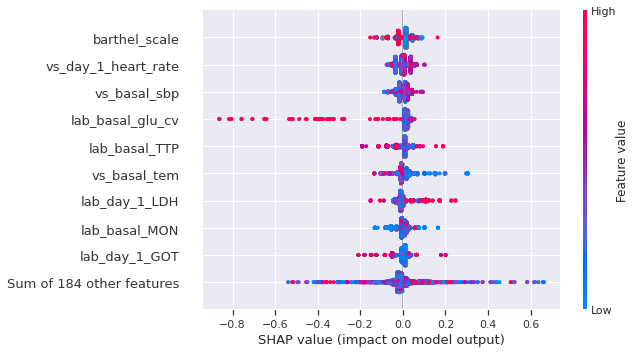

In [418]:
shap.plots.beeswarm(shap_values)

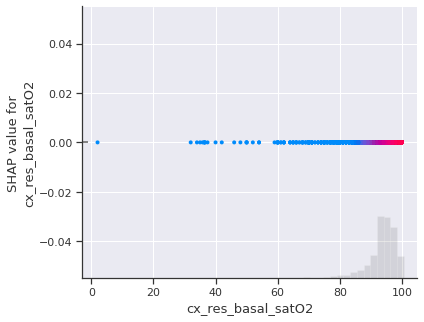

In [419]:
# create a dependence scatter plot to show the effect of a single feature across the whole dataset
shap.initjs()
shap.plots.scatter(shap_values[:,'cx_res_basal_satO2'], color=shap_values)

Feature Id     lab_basal_MON
Importances         7.547257
Name: 2, dtype: object


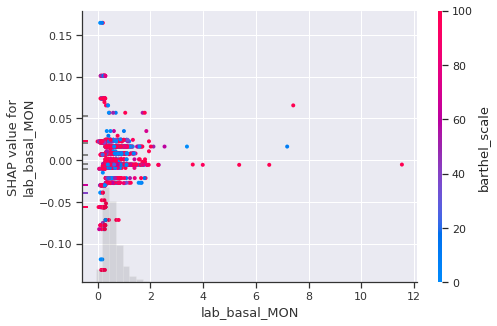

Feature Id     vs_basal_tem
Importances        7.494121
Name: 3, dtype: object


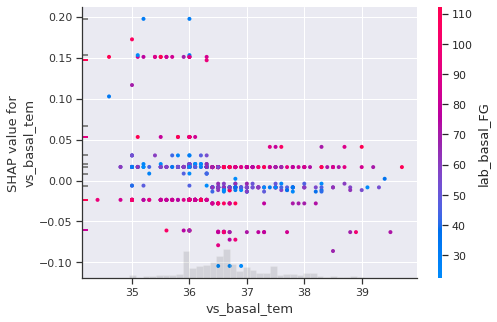

Feature Id     lab_day_1_LDH
Importances         6.436634
Name: 4, dtype: object


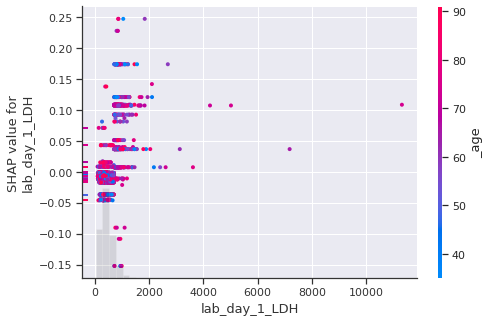

Feature Id     lab_day_1_MON
Importances         6.290098
Name: 5, dtype: object


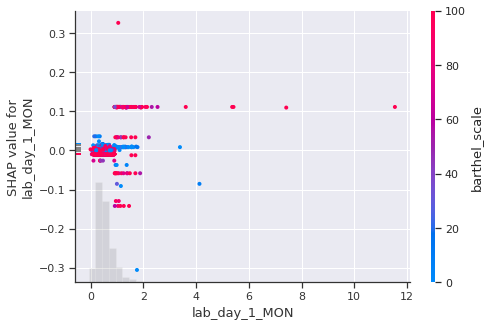

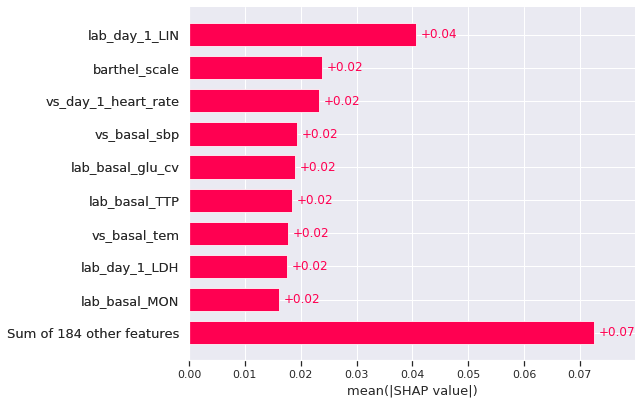

In [420]:
#plot top 5 features by importance

for f in importances[2:6].iterrows():
    print(f[1])
    shap.plots.scatter(shap_values[:,f[1]['Feature Id']], color=shap_values)
    


shap.plots.bar(shap_values)



#### Draw KM sv curves to proof positive/negative tto effect on test set

In [421]:
new_X = ex[ex.index.isin(X_test.index) | ex.index.isin(X_val.index)]
new_X = ex[ex.index.isin(X_test.index)]


In [422]:
test_pool = Pool(new_X[x_vars], 
                new_X.y_binomial, 
                weight = new_X.sIPTW,
                cat_features=['_gender'])


In [423]:
new_val = model.predict(test_pool, 
        prediction_type='Probability',
        ntree_start=0, 
        ntree_end=0, 
        thread_count=-1,
        verbose=None)

In [424]:
#list(zip(new_X.y_binomial,new_val))

In [425]:
new_X['pred'] = np.argmax(new_val, axis = 1)
new_X[['pred', 'y_binomial', 'y_who', f'tx_bin_{tt}']].head()


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


,pred,y_binomial,y_who,tx_bin_Dummy
4336,0,0,0,1
4338,0,0,1,0
4340,1,0,1,0
4344,0,0,1,0
4349,0,0,1,0


#### 1.1) ML Positive effect test: In the subset of patients recommended to treatment by the ML algorithm, test if those who actually received it had better outcome than those who did not receive it

In [426]:
km_df = new_X[(new_X.survival < 600 ) & (new_X.survival >= 0 ) & (new_X.pred == True)]
print(km_df.shape)
km_df.describe()

(671, 1090)


index  _health_dep        _age     date_in  barthel_scale  \
count  671.000000   671.000000  671.000000  671.000000     366.000000   
mean     0.259314    18.228018   64.283159  291.295082      76.120219   
std      0.723671     0.974383   18.985155  109.516656      36.840668   
min      0.000000    17.000000    0.000000   22.000000       0.000000   
25%      0.000000    17.000000   53.000000  253.000000      56.250000   
50%      0.000000    19.000000   65.000000  336.000000     100.000000   
75%      0.000000    19.000000   80.000000  377.000000     100.000000   
max      8.000000    19.000000   96.000000  393.000000     100.000000   

       n_covid_rel_dx  n_covid_rel_image  covid_rel_image    n_PCRs_+  \
count      671.000000         671.000000       671.000000  671.000000   
mean         1.660209           0.491803         0.418778    1.336811   
std          1.283958           0.655294         0.493727    0.743008   
min          0.000000           0.000000         0.000000    0.000000   
25%          0.000000           0.000000         0.000000    1.000000   
50%          2.000000           0.000000         0.000000    1.000000   
75%          2.000000           1.000000         1.000000    2.000000   
max          9.000000           4.000000         1.000000    5.000000   

       sofa_scale  glasgow    severity   1Diabetes   2Diabetes   ARDS  \
count   23.000000      0.0  671.000000  671.000000  671.000000  671.0   
mean     1.956522      NaN    3.040238    0.004471    0.122206    0.0   
std      1.664557      NaN    1.019155    0.066765    0.327768    0.0   
min      0.000000      NaN    1.000000    0.000000    0.000000    0.0   
25%      1.000000      NaN    2.000000    0.000000    0.000000    0.0   
50%      2.000000      NaN    3.000000    0.000000    0.000000    0.0   
75%      3.000000      NaN    3.000000    0.000000    0.000000    0.0   
max      6.000000      NaN    5.000000    1.000000    1.000000    0.0   

       Acute_bronchitis  Acute_kidney  CNS_cognitive  CNS_ischemia  \
count        671.000000    671.000000     671.000000    671.000000   
mean           0.002981      0.056632       0.070045      0.007452   
std            0.054554      0.231310       0.255413      0.086064   
min            0.000000      0.000000       0.000000      0.000000   
25%            0.000000      0.000000       0.000000      0.000000   
50%            0.000000      0.000000       0.000000      0.000000   
75%            0.000000      0.000000       0.000000      0.000000   
max            1.000000      1.000000       1.000000      1.000000   

       Cardiovascular  Covid_respiratory_interst  Covid_respiratory_other  \
count      671.000000                 671.000000               671.000000   
mean         0.199702                   0.043219                 0.202683   
std          0.400075                   0.203502                 0.402298   
min          0.000000                   0.000000                 0.000000   
25%          0.000000                   0.000000                 0.000000   
50%          0.000000                   0.000000                 0.000000   
75%          0.000000                   0.000000                 0.000000   
max          1.000000                   1.000000                 1.000000   

       Covid_respiratory_pneu  Covid_respiratory_pneu_other  \
count              671.000000                    671.000000   
mean                 0.517139                      0.056632   
std                  0.500079                      0.231310   
min                  0.000000                      0.000000   
25%                  0.000000                      0.000000   
50%                  1.000000                      0.000000   
75%                  1.000000                      0.000000   
max                  1.000000                      1.000000   

       Covid_respiratory_upp  Cytokine_RS  Disseminated_IC   Enteritis  \
count             671.000000        671.0            671.0  671.000000 

In [427]:
#descriptive statistics 
#print(*ex.columns, sep = ', ')
#['_age','_gender', 'Cardiovascular', 'Heart_disease', 'Malignancy','']
new_X[(new_X.survival < 600 ) & (new_X.survival >= 0 ) ].describe()



index  _health_dep         _age      date_in  barthel_scale  \
count  2067.000000  2067.000000  2067.000000  2067.000000    1260.000000   
mean      0.283986    18.147557    65.631350   284.707305      77.293651   
std       0.882853     0.989293    18.682463   113.313685      35.631948   
min       0.000000    17.000000     0.000000     6.000000       0.000000   
25%       0.000000    17.000000    54.000000   240.000000      60.000000   
50%       0.000000    19.000000    68.000000   333.000000     100.000000   
75%       0.000000    19.000000    81.000000   374.000000     100.000000   
max      25.000000    19.000000   101.000000   393.000000     100.000000   

       n_covid_rel_dx  n_covid_rel_image  covid_rel_image     n_PCRs_+  \
count     2067.000000        2067.000000      2067.000000  2067.000000   
mean         1.712627           0.519110         0.417997     1.377842   
std          1.256021           0.748019         0.493349     0.851485   
min          0.000000           0.000000         0.000000     0.000000   
25%          1.000000           0.000000         0.000000     1.000000   
50%          2.000000           0.000000         0.000000     1.000000   
75%          2.000000           1.000000         1.000000     2.000000   
max          9.000000           8.000000         1.000000     9.000000   

       sofa_scale  glasgow     severity    1Diabetes    2Diabetes  \
count   70.000000      0.0  2067.000000  2067.000000  2067.000000   
mean     1.857143      NaN     2.995162     0.005322     0.148041   
std      1.965542      NaN     1.004817     0.072773     0.355226   
min      0.000000      NaN     1.000000     0.000000     0.000000   
25%      0.000000      NaN     2.000000     0.000000     0.000000   
50%      2.000000      NaN     3.000000     0.000000     0.000000   
75%      3.000000      NaN     3.000000     0.000000     0.000000   
max     10.000000      NaN     5.000000     1.000000     1.000000   

              ARDS  Acute_bronchitis  Acute_kidney  CNS_cognitive  \
count  2067.000000       2067.000000   2067.000000    2067.000000   
mean      0.000484          0.002903      0.059023       0.064344   
std       0.021995          0.053812      0.235724       0.245425   
min       0.000000          0.000000      0.000000       0.000000   
25%       0.000000          0.000000      0.000000       0.000000   
50%       0.000000          0.000000      0.000000       0.000000   
75%       0.000000          0.000000      0.000000       0.000000   
max       1.000000          1.000000      1.000000       1.000000   

       CNS_ischemia  Cardiovascular  Covid_respiratory_interst  \
count   2067.000000     2067.000000                2067.000000   
mean       0.009192        0.208515                   0.045477   
std        0.095457        0.406345                   0.208397   
min        0.000000        0.000000                   0.000000   
25%        0.000000        0.000000                   0.000000   
50%        0.000000        0.000000                   0.000000   
75%        0.000000        0.000000                   0.000000   
max        1.000000        1.000000                   1.000000   

       Covid_respiratory_other  Covid_respiratory_pneu  \
count              2067.000000             2067.000000   
mean                  0.210934                0.533140   
std                   0.408070                0.499021   
min                   0.000000                0.000000   
25%                   0.000000                0.000000   
50%                   0.000000                1.000000   
75%                   0.000000                1.000000   
max                   1.000000                1.000000   

       Covid_respiratory_pneu_other  Covid_respiratory_upp  Cytokine_RS  \
count                   2067.000000            2067.000000       2067.0   
mean                       0.058539               0.000968          0.0   
std                        0.234817               0.031099          0.0   

(671, 1090)


It looks like your weights are not integers, possibly propensity scores then?
  It's important to know that the naive variance estimates of the coefficients are biased. Instead use Monte Carlo to
  estimate the variances. See paper "Variance estimation when using inverse probability of treatment weighting (IPTW) with survival analysis"
  or "Adjusted Kaplan-Meier estimator and log-rank test with inverse probability of treatment weighting for survival data."
                  
It looks like your weights are not integers, possibly propensity scores then?
  It's important to know that the naive variance estimates of the coefficients are biased. Instead use Monte Carlo to
  estimate the variances. See paper "Variance estimation when using inverse probability of treatment weighting (IPTW) with survival analysis"
  or "Adjusted Kaplan-Meier estimator and log-rank test with inverse probability of treatment weighting for survival data."
                  


<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.06 0.81      0.31

<lifelines.CoxPHFitter: fitted with 520.448 total observations, 447.473 right-censored observations>
             duration col = 'survival'
                event col = 'dead'
              weights col = 'sIPTW'
          robust variance = True
      baseline estimation = breslow
   number of observations = 520.448
number of events observed = 72.9754
   partial log-likelihood = -425.04
         time fit was run = 2021-06-14 14:18:25 UTC

---
               coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                            
tx_bin_Dummy  -0.06       0.94       0.27            -0.59             0.47                 0.56                 1.60

                 z    p   -log2(p)
covariate                         
tx_bin_Dummy -0.22 0.82       0.28
---
Concordance = 0.51
Partial AIC = 852.07
log-likelihood ratio test = 0.07 on 1 df
-log2(p) of ll-ratio test = 0.32

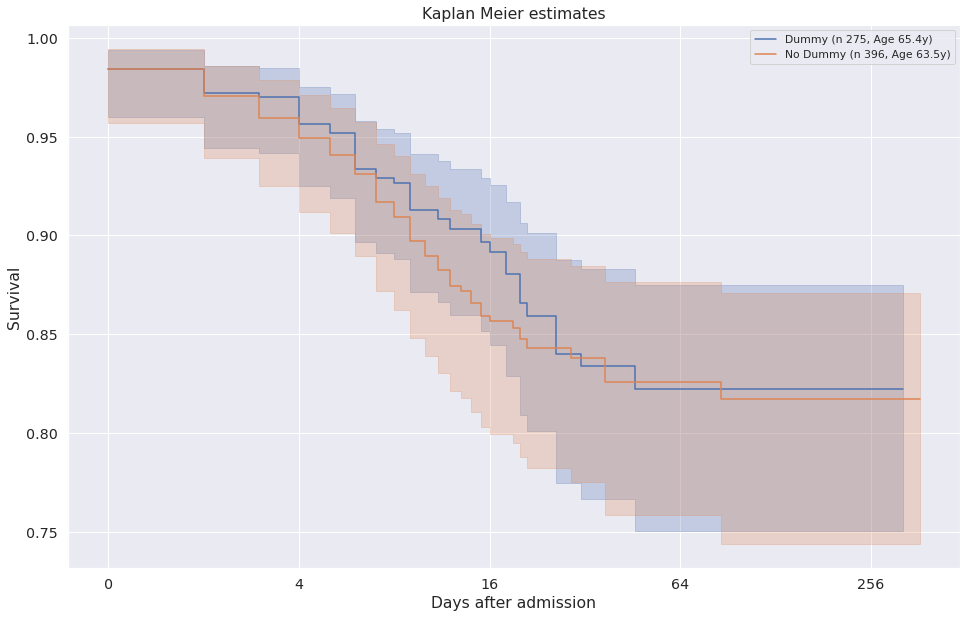

In [428]:
sv_tx_graph(km_df, tt, log = True, adjusted = True )

#### 1.2) Guidelines Positive effect test: In the subset of patients recommended to treatment by current guidelines, test if those who actually received it had better outcome than those who did not receive it


###### Treatment indication: patient who require supplemental oxygen = cx_res_day_1_fiO2 > 21 or cx_res_basal_fiO2 > 21 


In [429]:

#new_X = ex[ex.index.isin(X_test.index)]
km_df = new_X[(new_X.survival < 600 ) & (new_X.survival >= 0 ) & ((new_X.cx_res_basal_fiO2 > 21) | (new_X.cx_res_day_1_fiO2 > 21)) == True]
km_df.shape

(911, 1090)

(911, 1090)


It looks like your weights are not integers, possibly propensity scores then?
  It's important to know that the naive variance estimates of the coefficients are biased. Instead use Monte Carlo to
  estimate the variances. See paper "Variance estimation when using inverse probability of treatment weighting (IPTW) with survival analysis"
  or "Adjusted Kaplan-Meier estimator and log-rank test with inverse probability of treatment weighting for survival data."
                  
It looks like your weights are not integers, possibly propensity scores then?
  It's important to know that the naive variance estimates of the coefficients are biased. Instead use Monte Carlo to
  estimate the variances. See paper "Variance estimation when using inverse probability of treatment weighting (IPTW) with survival analysis"
  or "Adjusted Kaplan-Meier estimator and log-rank test with inverse probability of treatment weighting for survival data."
                  


<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           1.39 0.24      2.07

<lifelines.CoxPHFitter: fitted with 616.528 total observations, 498.041 right-censored observations>
             duration col = 'survival'
                event col = 'dead'
              weights col = 'sIPTW'
          robust variance = True
      baseline estimation = breslow
   number of observations = 616.528
number of events observed = 118.487
   partial log-likelihood = -709.63
         time fit was run = 2021-06-14 14:18:28 UTC

---
               coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                            
tx_bin_Dummy   0.20       1.22       0.18            -0.16             0.55                 0.85                 1.74

                z    p   -log2(p)
covariate                        
tx_bin_Dummy 1.07 0.28       1.82
---
Concordance = 0.52
Partial AIC = 1421.27
log-likelihood ratio test = 1.14 on 1 df
-log2(p) of ll-ratio test = 1.80

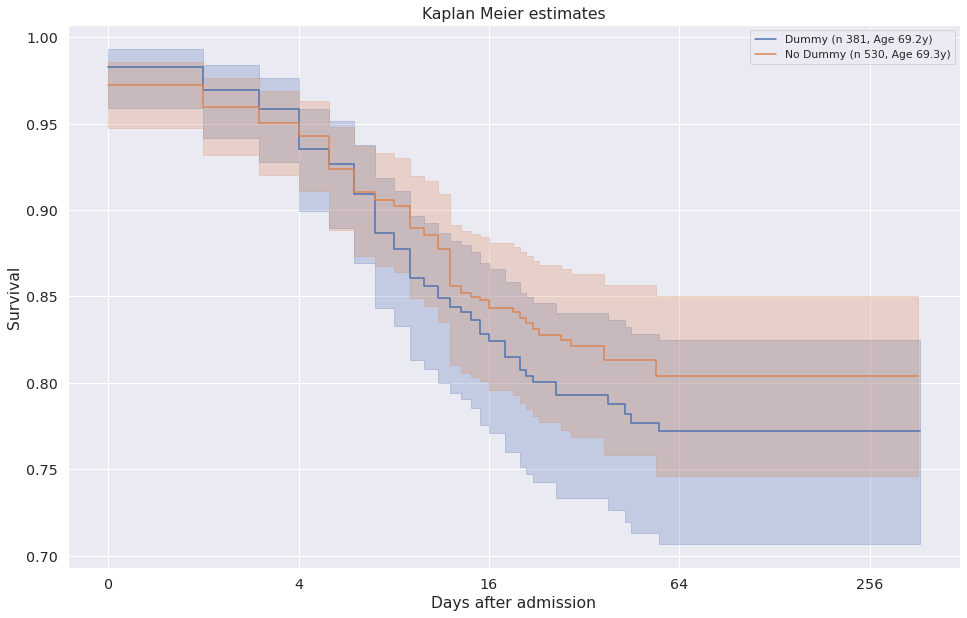

In [430]:
sv_tx_graph(km_df, tt, log = True , adjusted = True)

#### 2.1) ML  Negative effect test: In the subset of patients NOT recommended to treatment by the ML algorithm, test if those who actually received it had equal or worse outcome (i.e. there was no benefit) than those who did not receive it

(1396, 1090)


It looks like your weights are not integers, possibly propensity scores then?
  It's important to know that the naive variance estimates of the coefficients are biased. Instead use Monte Carlo to
  estimate the variances. See paper "Variance estimation when using inverse probability of treatment weighting (IPTW) with survival analysis"
  or "Adjusted Kaplan-Meier estimator and log-rank test with inverse probability of treatment weighting for survival data."
                  
It looks like your weights are not integers, possibly propensity scores then?
  It's important to know that the naive variance estimates of the coefficients are biased. Instead use Monte Carlo to
  estimate the variances. See paper "Variance estimation when using inverse probability of treatment weighting (IPTW) with survival analysis"
  or "Adjusted Kaplan-Meier estimator and log-rank test with inverse probability of treatment weighting for survival data."
                  


<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           1.45 0.23      2.13

<lifelines.CoxPHFitter: fitted with 985.859 total observations, 839.43 right-censored observations>
             duration col = 'survival'
                event col = 'dead'
              weights col = 'sIPTW'
          robust variance = True
      baseline estimation = breslow
   number of observations = 985.859
number of events observed = 146.429
   partial log-likelihood = -937.79
         time fit was run = 2021-06-14 14:18:31 UTC

---
               coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                            
tx_bin_Dummy   0.05       1.05       0.17            -0.28             0.38                 0.76                 1.47

                z    p   -log2(p)
covariate                        
tx_bin_Dummy 0.31 0.76       0.40
---
Concordance = 0.53
Partial AIC = 1877.58
log-likelihood ratio test = 0.10 on 1 df
-log2(p) of ll-ratio test = 0.41

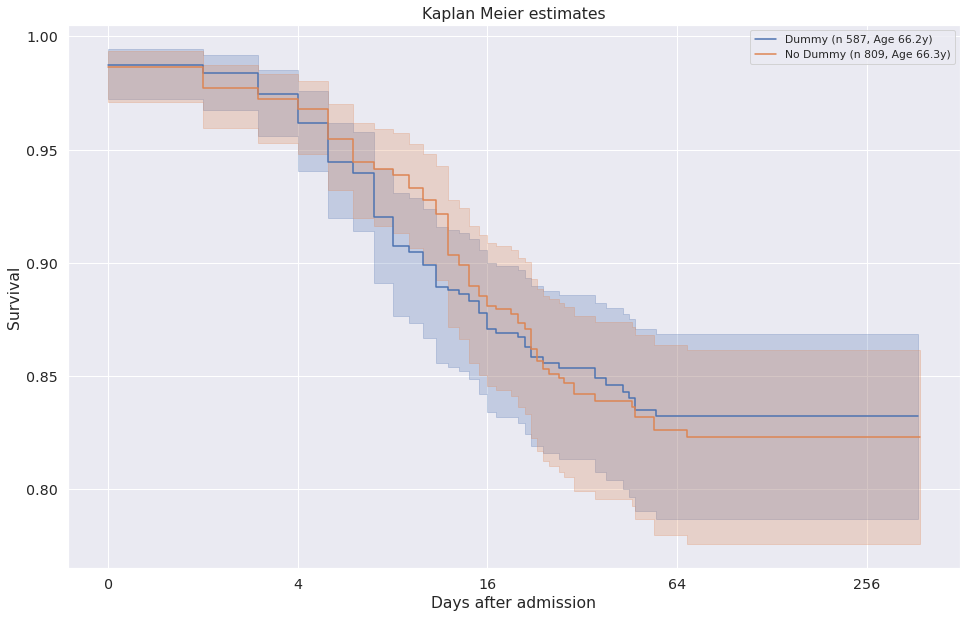

In [431]:
km_df = new_X[(new_X.survival < 600 ) & (new_X.survival >= 0 ) & (new_X.pred == False)]
km_df.shape



sv_tx_graph(km_df, tt, log = True, adjusted = True )



#### 2.2) Guidelines Negative effect test: In the subset of patients NOT recommended to treatment by current guidelines, test if those who actually received it had equal or worse outcome (i.e. there was no benefit) than those who did not receive it


###### Treatment indication: patient who require supplemental oxygen = cx_res_day_1_fiO2 > 21 or cx_res_basal_fiO2 > 21 


(1156, 1090)


It looks like your weights are not integers, possibly propensity scores then?
  It's important to know that the naive variance estimates of the coefficients are biased. Instead use Monte Carlo to
  estimate the variances. See paper "Variance estimation when using inverse probability of treatment weighting (IPTW) with survival analysis"
  or "Adjusted Kaplan-Meier estimator and log-rank test with inverse probability of treatment weighting for survival data."
                  
It looks like your weights are not integers, possibly propensity scores then?
  It's important to know that the naive variance estimates of the coefficients are biased. Instead use Monte Carlo to
  estimate the variances. See paper "Variance estimation when using inverse probability of treatment weighting (IPTW) with survival analysis"
  or "Adjusted Kaplan-Meier estimator and log-rank test with inverse probability of treatment weighting for survival data."
                  


<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.01 0.91      0.13

<lifelines.CoxPHFitter: fitted with 889.779 total observations, 788.861 right-censored observations>
             duration col = 'survival'
                event col = 'dead'
              weights col = 'sIPTW'
          robust variance = True
      baseline estimation = breslow
   number of observations = 889.779
number of events observed = 100.918
   partial log-likelihood = -632.73
         time fit was run = 2021-06-14 14:18:35 UTC

---
               coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                            
tx_bin_Dummy  -0.11       0.90       0.21            -0.52             0.31                 0.59                 1.36

                 z    p   -log2(p)
covariate                         
tx_bin_Dummy -0.50 0.62       0.69
---
Concordance = 0.49
Partial AIC = 1267.46
log-likelihood ratio test = 0.28 on 1 df
-log2(p) of ll-ratio test = 0.74

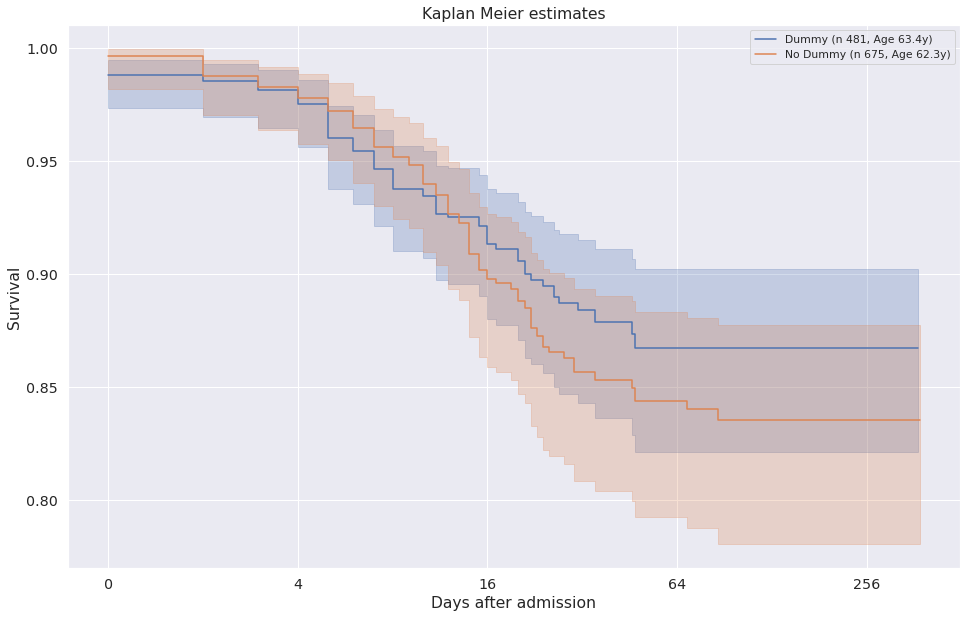

In [432]:

km_df = new_X[(new_X.survival < 600 ) & (new_X.survival >= 0 ) & ((new_X.cx_res_basal_fiO2 > 21) | (new_X.cx_res_day_1_fiO2 > 21)) == False]
km_df.shape

sv_tx_graph(km_df, tt, log = True , adjusted = True)